In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
import plotly.express as px
from sklearn.preprocessing import MinMaxScaler, OrdinalEncoder
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import nbformat

In [2]:
dados = pd.read_csv('../propensity-model/loan_default.csv')
dados.drop(columns=['rate_of_interest', 'Interest_rate_spread', 'Upfront_charges'], inplace=True)
dados.dropna(inplace=True)

In [32]:
dados.head()

,ID,year,loan_limit,Gender,approv_in_adv,loan_type,loan_purpose,Credit_Worthiness,open_credit,business_or_commercial,...,Credit_Score,co_applicant_credit_type,age,submission_of_application,LTV,Region,Security_Type,Status,dtir1,Cluster
4498,66991,2019,1.0,2.0,0.0,0.0,3.0,0.0,0.0,1.0,...,796,0.0,2.0,1.0,48.046875,0.0,1.0,1,18.0,2
4499,129375,2019,1.0,2.0,0.0,0.0,3.0,0.0,0.0,1.0,...,792,0.0,2.0,1.0,48.046875,0.0,1.0,0,20.0,2
4500,135098,2019,0.0,2.0,0.0,0.0,3.0,0.0,0.0,1.0,...,800,0.0,1.0,0.0,48.046875,3.0,1.0,0,42.0,4
4501,34773,2019,0.0,2.0,0.0,0.0,3.0,0.0,0.0,1.0,...,728,1.0,1.0,1.0,46.093750,3.0,1.0,0,37.0,0
4502,46136,2019,0.0,2.0,1.0,0.0,0.0,0.0,0.0,1.0,...,726,0.0,3.0,1.0,46.093750,3.0,1.0,0,23.0,2


In [3]:
# Codificação das variáveis categóricas
encoder = OrdinalEncoder()
cat_attrs = dados.select_dtypes(include=['object']).columns
dados[cat_attrs] = encoder.fit_transform(dados[cat_attrs])

In [4]:
# Normalização dos dados
scaler = MinMaxScaler()
dados_norm = scaler.fit_transform(dados.drop('Status', axis=1))
features = dados.drop('Status', axis=1).columns

In [5]:
# Redução de dimensionalidade com PCA
pca = PCA(n_components=3)
dados_pca = pca.fit_transform(dados_norm)

In [6]:
# Clustering com KMeans
kmeans = KMeans(n_clusters=5, random_state=42)
dados['Cluster'] = kmeans.fit_predict(dados_pca)

In [8]:
# Avaliação do modelo de clustering
silhouette_avg = silhouette_score(dados_norm, dados['Cluster'])
print(f'Silhouette Score: {silhouette_avg:.2f}')

Silhouette Score: 0.13


In [7]:
# Visualização dos clusters em 3D
fig = px.scatter_3d(
    dados,
    x=dados_pca[:, 0],
    y=dados_pca[:, 1],
    z=dados_pca[:, 2],
    color='Cluster',
    title='Visualização 3D dos Clusters'
)
fig.show()

In [9]:
# Avaliação detalhada dos clusters
def cluster_analysis(cluster_id):
    cluster_data = dados[dados['Cluster'] == cluster_id]
    return {
        'Cluster ID': cluster_id,
        'Quantidade': cluster_data.shape[0],
        'Renda Média': cluster_data['income'].mean(),
        'Faixa de Pontuação de Crédito': [cluster_data['Credit_Score'].min(), cluster_data['Credit_Score'].max()],
        'Taxa de Inadimplência': cluster_data['Status'].mean()
    }

cluster_details = pd.DataFrame([cluster_analysis(i) for i in range(5)])
cluster_details

,Cluster ID,Quantidade,Renda Média,Faixa de Pontuação de Crédito,Taxa de Inadimplência
0,0,31451,7297.559378,"[500, 900]",0.165941
1,1,13693,7221.895859,"[500, 900]",0.111006
2,2,45936,5313.791797,"[500, 900]",0.221090
3,3,21213,9853.364446,"[500, 900]",0.085796
4,4,8233,7817.563464,"[500, 900]",0.113203


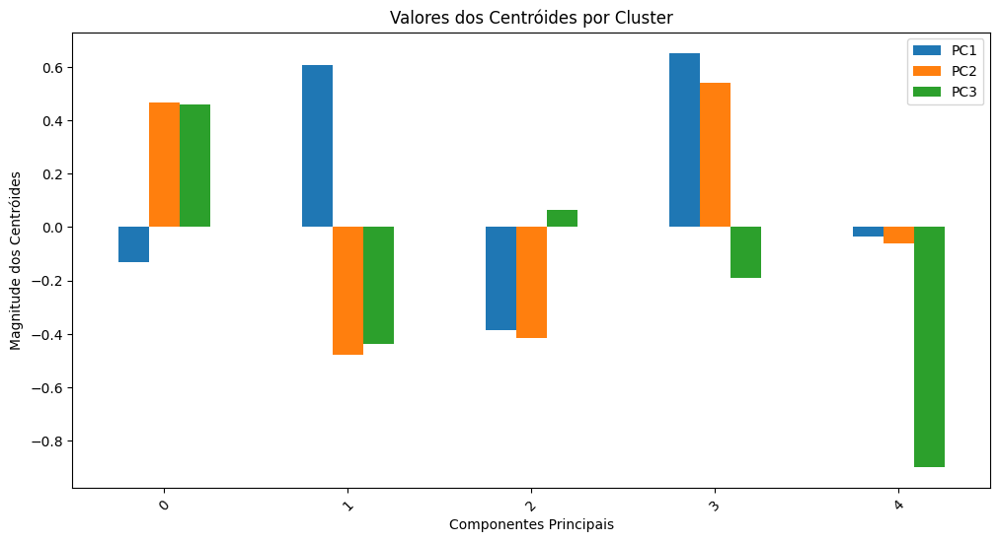

In [11]:
# Visualização dos centróides dos clusters
centroids = kmeans.cluster_centers_
# As colunas agora devem corresponder ao número de componentes do PCA
df_centroids = pd.DataFrame(centroids, columns=[f'PC{i+1}' for i in range(centroids.shape[1])])  
df_centroids.plot(kind='bar', figsize=(12, 6))
plt.title('Valores dos Centróides por Cluster')
plt.ylabel('Magnitude dos Centróides')
plt.xlabel('Componentes Principais')
plt.xticks(rotation=45)
plt.show()

In [12]:
# Visualização paralela das categorias dos clusters
fig = px.parallel_categories(
    dados,
    dimensions=['Cluster', 'loan_purpose', 'Security_Type', 'age', 'Region'],
    color='Cluster',
    title='Categorias Paralelas para Clusters'
)
fig.show()

In [19]:
# Atualizando dados de clusters com informações adicionais
dados_cluster = pd.DataFrame(dados_pca, columns=[f'Component_{i}' for i in range(dados_pca.shape[1])])
dados_cluster['Status'] = dados['Status']
dados_cluster['Cluster'] = dados['Cluster']
dados_cluster['PontuacaoCredito'] = dados['Credit_Score']
dados_cluster['Regiao'] = dados['Region']
dados_cluster['Idade'] = dados['age']

dados_cluster.dropna(inplace=True)
dados_cluster.reset_index(drop=True, inplace=True)

In [21]:
# Função para classificar a pontuação de crédito
def classifica_pontuacao(pontuacao):
    if pontuacao < 600:
        return "baixa"
    elif pontuacao < 700:
        return "media"
    else:
        return "alta"

# Avaliação de cada cluster
def avalia_cluster(cluster_id):
    dados_filtrados = dados_cluster[dados_cluster['Cluster'] == cluster_id]
    inadimplentes = dados_filtrados['Status']
    if inadimplentes.empty:
        return {'cluster': cluster_id, 'total': 0}

    taxa_inadimplencia = inadimplentes.mean()
    return {
        'cluster': cluster_id,
        'total': len(inadimplentes),
        'inadimplentes': inadimplentes.sum(),
        'taxa_inadimplencia': taxa_inadimplencia,
        'media_pontuacao': dados_filtrados['PontuacaoCredito'].mean(),
        'media_pontuacao_inadimplentes': dados_filtrados[dados_filtrados['Status'] == 1]['PontuacaoCredito'].mean(),
    }

def cria_persona(linha):
    descricao = classifica_pontuacao(linha['PontuacaoCredito'])
    return f"Pessoa com pontuação {descricao}, da região {linha['Regiao']}, com {linha['Idade']} anos."

# Aplicação das avaliações
estatisticas_clusters = pd.DataFrame([avalia_cluster(i) for i in range(5)])
estatisticas_clusters = estatisticas_clusters[['cluster', 'taxa_inadimplencia', 'media_pontuacao', 'media_pontuacao_inadimplentes']]
estatisticas_clusters

,cluster,taxa_inadimplencia,media_pontuacao,media_pontuacao_inadimplentes
0,0,0.166797,699.295103,701.655230
1,1,0.110996,699.880000,702.516622
2,2,0.219600,699.093467,698.348947
3,3,0.085922,699.959318,705.859862
4,4,0.109720,698.477811,700.001241


In [28]:
# Criação e salvamento de personas
print(cria_persona(dados_cluster.iloc[90]))

Pessoa com pontuação media, da região 3.0, com 1.0 anos.


In [29]:
# Salvamento de objetos para reutilização
pickle.dump(encoder, open('docker/artifacts/encoder_categorias.pkl', 'wb'))
pickle.dump(scaler, open('docker/artifacts/normalizador.pkl', 'wb'))
pickle.dump(kmeans, open('docker/artifacts/modelo_kmeans.pkl', 'wb'))

In [33]:
# Preparação de amostra de dados para testes da API
amostra_api = dados[['loan_purpose',
 'Security_Type',
 'age',
 'Region',
 'year',
 'loan_amount',
 'term',
 'property_value',
 'income',
 'Credit_Score',
 'LTV',
 'dtir1']].iloc[0].to_json()
amostra_api

'{"loan_purpose":3.0,"Security_Type":1.0,"age":2.0,"Region":0.0,"year":2019.0,"loan_amount":676500.0,"term":360.0,"property_value":1408000.0,"income":19380.0,"Credit_Score":796.0,"LTV":48.046875,"dtir1":18.0}'

In [34]:
with open("docker/amostra_requisicao.json", "w") as file:
    file.write(amostra_api)